## Explorent Component

    In introduction, we mentioned that during the explorent component part, where we have to adress our own question and answer it through the data science cycle, we have chosen two deal with two different things. The first one, extending the dataset with weather data and check how they improve or not our models performance. Last but not least, as the most difficult, to make a prediction not for the overall pickups but by clustering Boston's station and predict the rides per cluster.

In [1]:
%load_ext autoreload
%autoreload 2
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import main as main
from tabulate import tabulate
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.multioutput import MultiOutputRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.linear_model import LogisticRegression
from sklearn.cluster import KMeans
from sklearn.metrics import r2_score, mean_squared_error

# Part 1. Prediction With Data From Other Sources

## Feautures Engineering And Analysis

### *Pickups Data*

In [2]:
data = pd.read_csv('BikeSharing_Bluebikes2022.csv', index_col=0)

/home/georgep/anaconda3/envs/MachineLearning/lib/python3.8/site-packages/numpy/lib/arraysetops.py:580: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask |= (ar1 == a)


In [3]:
data.head()

,tripduration,starttime,stoptime,start station id,start station name,start station latitude,start station longitude,end station id,end station name,end station latitude,end station longitude,bikeid,usertype,postal code
0,597,2022-01-01 00:00:25.1660,2022-01-01 00:10:22.1920,178,MIT Pacific St at Purrington St,42.359573,-71.101295,74,Harvard Square at Mass Ave/ Dunster,42.373268,-71.118579,4923,Subscriber,02139
1,411,2022-01-01 00:00:40.4300,2022-01-01 00:07:32.1980,189,Kendall T,42.362428,-71.084955,178,MIT Pacific St at Purrington St,42.359573,-71.101295,3112,Subscriber,02139
2,476,2022-01-01 00:00:54.8180,2022-01-01 00:08:51.6680,94,Main St at Austin St,42.375603,-71.064608,356,Charlestown Navy Yard,42.374125,-71.054812,6901,Customer,02124
3,466,2022-01-01 00:01:01.6080,2022-01-01 00:08:48.2350,94,Main St at Austin St,42.375603,-71.064608,356,Charlestown Navy Yard,42.374125,-71.054812,5214,Customer,02124
4,752,2022-01-01 00:01:06.0520,2022-01-01 00:13:38.2300,19,Park Dr at Buswell St,42.347241,-71.105301,41,Packard's Corner - Commonwealth Ave at Brighto...,42.352261,-71.123831,2214,Subscriber,02215


In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2305735 entries, 0 to 487200
Data columns (total 14 columns):
 #   Column                   Dtype  
---  ------                   -----  
 0   tripduration             int64  
 1   starttime                object 
 2   stoptime                 object 
 3   start station id         int64  
 4   start station name       object 
 5   start station latitude   float64
 6   start station longitude  float64
 7   end station id           int64  
 8   end station name         object 
 9   end station latitude     float64
 10  end station longitude    float64
 11  bikeid                   int64  
 12  usertype                 object 
 13  postal code              object 
dtypes: float64(4), int64(4), object(6)
memory usage: 263.9+ MB


In [5]:
#transforming the dates from object to datetime
for date_column in ['starttime','stoptime']:
    data[date_column] = pd.to_datetime(data[date_column], format='%Y-%m-%d %H:%M:%S')

In [6]:
'''
Again with the DatetimeInterval function we set the datetime as the index and calculate the pickups during 
the intervals as before.
'''
df15 = main.DatetimeInterval(data, freq='15Min')
df30 = main.DatetimeInterval(data, freq='30Min')
df60 = main.DatetimeInterval(data, freq='60Min')
df120 = main.DatetimeInterval(data, freq='120Min')

### *Weather Data*

    These Weather Data have been downloaded from https://www.visualcrossing.com/weather-data using the Easy Global Weather API. They are hourly observations from weather stations of Boston also from the 01/01/2022 until the 31/08/2022. Since they have many different columns they will definitely need to be preproccessed. 
    Let's start then!

In [7]:
weather_data = pd.read_csv('Data/WeatherData', index_col=0)

In [8]:
weather_data.head()

,name,datetime,temp,feelslike,dew,humidity,precip,precipprob,preciptype,snow,...,sealevelpressure,cloudcover,visibility,solarradiation,solarenergy,uvindex,severerisk,conditions,icon,stations
0,Boston,2022-01-01T00:00:00,7.8,7.8,6.7,92.50,0.0,0,NaN,0.0,...,1014.5,100.0,8.0,NaN,NaN,NaN,NaN,Overcast,cloudy,"KOWD,72509854704,KBED,KBOS,72509014739,7250591..."
1,Boston,2022-01-01T01:00:00,7.2,6.5,6.7,96.49,0.0,0,NaN,0.0,...,1014.1,100.0,5.1,NaN,NaN,NaN,NaN,Overcast,cloudy,"KOWD,72509854704,KBED,KBOS,72509014739,7250591..."
2,Boston,2022-01-01T02:00:00,7.2,6.0,6.7,96.49,0.0,0,NaN,0.0,...,1014.2,100.0,4.0,NaN,NaN,NaN,NaN,Overcast,cloudy,"KOWD,72509854704,KBED,KBOS,72509014739,7250591..."
3,Boston,2022-01-01T03:00:00,7.2,7.2,6.7,96.60,0.0,0,NaN,0.0,...,1014.1,100.0,1.0,NaN,NaN,NaN,NaN,Overcast,cloudy,"KOWD,72509854704,KBED,KBOS,72509014739,7250591..."
4,Boston,2022-01-01T04:00:00,6.8,5.4,6.7,99.79,0.0,0,NaN,0.0,...,1013.6,100.0,0.0,NaN,NaN,NaN,NaN,Overcast,cloudy,"KOWD,72509854704,KBED,KBOS,72509014739,7250591..."


In [9]:
weather_data['datetime'] = pd.to_datetime(weather_data['datetime'], format='%Y-%m-%dT%H:%M:%S')
weather_data.drop('name',axis=1, inplace=True)
weather_data.set_index('datetime', inplace=True)

In [10]:
weather_data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 5831 entries, 2022-01-01 00:00:00 to 2022-08-31 23:00:00
Data columns (total 22 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   temp              5831 non-null   float64
 1   feelslike         5831 non-null   float64
 2   dew               5831 non-null   float64
 3   humidity          5831 non-null   float64
 4   precip            5831 non-null   float64
 5   precipprob        5831 non-null   int64  
 6   preciptype        547 non-null    object 
 7   snow              5831 non-null   float64
 8   snowdepth         5831 non-null   float64
 9   windgust          5675 non-null   float64
 10  windspeed         5831 non-null   float64
 11  winddir           5831 non-null   float64
 12  sealevelpressure  5831 non-null   float64
 13  cloudcover        5831 non-null   float64
 14  visibility        5831 non-null   float64
 15  solarradiation    5691 non-null   float64
 16  solare

In [11]:
weather_data.shape # the same shape as our hourly groupped data

(5831, 22)

#### Data Cleaning

    At first glance, we drop the columns that we think are not very helpful and on the other hand we will process the weather columns that we think are instead. Later we will probably drop a few of them based on the knowledge we will acquire through the cleaning and analysis.

In [12]:
weather_data.drop(['dew','windgust','precipprob','windgust','winddir','sealevelpressure','solarenergy','cloudcover','icon','stations'], axis=1, inplace=True)

In [13]:
weather_data.columns

Index(['temp', 'feelslike', 'humidity', 'precip', 'preciptype', 'snow',
       'snowdepth', 'windspeed', 'visibility', 'solarradiation', 'uvindex',
       'severerisk', 'conditions'],
      dtype='object')

    Checking for nan values and after that we start check each column one by one.

In [14]:
weather_data.isna().sum()

temp                 0
feelslike            0
humidity             0
precip               0
preciptype        5284
snow                 0
snowdepth            0
windspeed            0
visibility           0
solarradiation     140
uvindex            140
severerisk         230
conditions           0
dtype: int64

Temp

In [15]:
weather_data['temp'].describe()

count    5831.000000
mean       12.352478
std        11.056270
min       -15.600000
25%         4.300000
50%        12.900000
75%        21.600000
max        37.200000
Name: temp, dtype: float64

<AxesSubplot:xlabel='temp', ylabel='Count'>

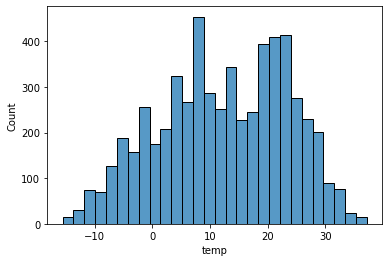

In [16]:
sns.histplot(data=weather_data, x="temp")

feelslike

In [17]:
weather_data['feelslike'].describe()

count    5831.000000
mean       10.596210
std        13.410548
min       -26.500000
25%         0.800000
50%        12.900000
75%        21.600000
max        39.500000
Name: feelslike, dtype: float64

<AxesSubplot:xlabel='feelslike', ylabel='Count'>

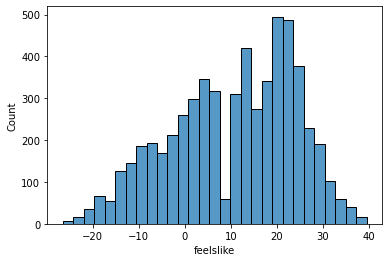

In [18]:
sns.histplot(data=weather_data, x="feelslike")

     They seem very simillar except from the upper and lower bounds, something very reasonable as in extreme temperatures the feel is even worse that the observed value. 

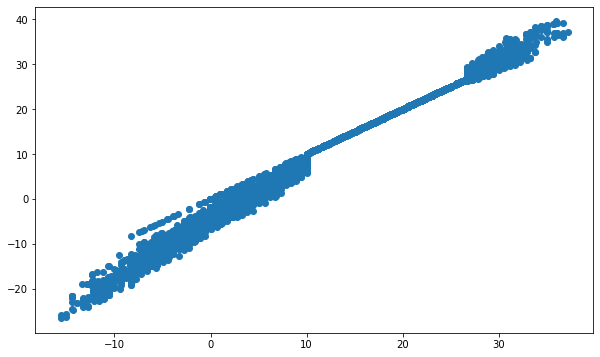

In [19]:
plt.figure(figsize=(10,6))
plt.scatter(x='temp',y='feelslike', data=weather_data)

Humidity

In [20]:
weather_data['humidity'].describe()

count    5831.000000
mean       62.503353
std        20.229678
min        15.130000
25%        46.120000
50%        61.270000
75%        79.645000
max        99.940000
Name: humidity, dtype: float64

<AxesSubplot:xlabel='humidity', ylabel='Count'>

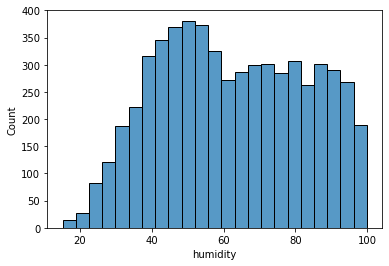

In [21]:
sns.histplot(data=weather_data, x="humidity")

precip

In [22]:
weather_data['precip'].describe()

count    5831.000000
mean        0.077047
std         0.451573
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max        10.546000
Name: precip, dtype: float64

<AxesSubplot:xlabel='precip', ylabel='Count'>

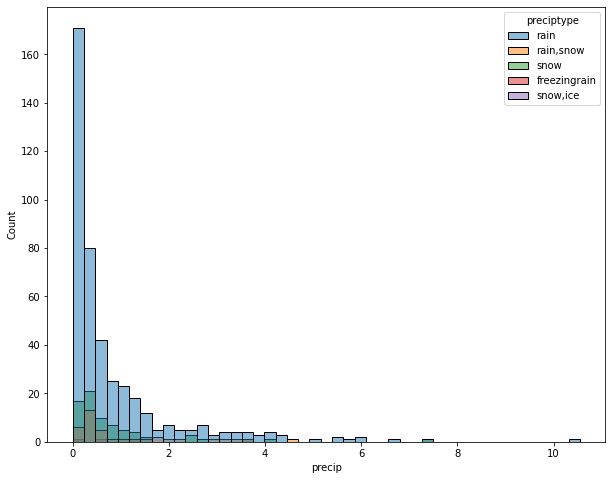

In [23]:
plt.figure(figsize=(10,8))
sns.histplot(data=weather_data, x="precip", hue="preciptype")

<AxesSubplot:xlabel='precip', ylabel='Count'>

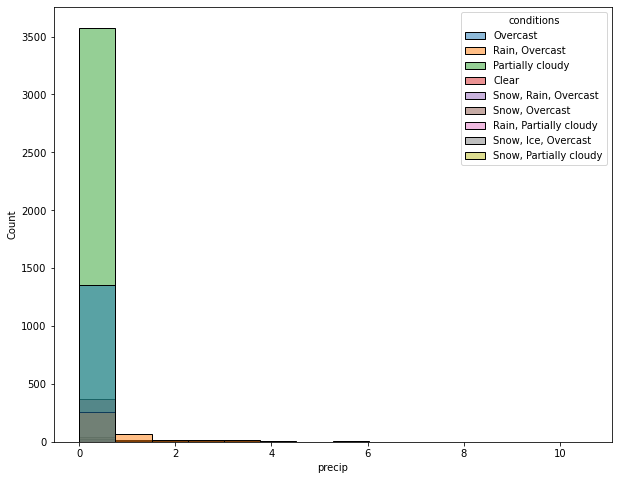

In [24]:
plt.figure(figsize=(10,8))
sns.histplot(data=weather_data, x="precip", hue="conditions")

In [25]:
weather_data[weather_data['precip']>0]['conditions'].unique()

array(['Rain, Overcast', 'Snow, Rain, Overcast', 'Snow, Overcast',
       'Rain, Partially cloudy', 'Snow, Ice, Overcast',
       'Snow, Partially cloudy'], dtype=object)

Preciptype

In [26]:
weather_data['preciptype'].nunique()

5

In [27]:
weather_data['preciptype'].unique()

array([nan, 'rain', 'rain,snow', 'snow', 'freezingrain', 'snow,ice'],
      dtype=object)

In [28]:
weather_data[weather_data['preciptype']=='snow'][['snow','snowdepth']]

,snow,snowdepth
datetime,,
2022-01-07 05:00:00,1.04,21.88
2022-01-24 00:00:00,0.00,0.10
2022-01-25 00:00:00,0.13,2.00
2022-01-25 01:00:00,0.13,2.13
2022-01-29 02:00:00,0.42,7.50
...,...,...
2022-03-03 03:00:00,0.70,13.42
2022-03-03 04:00:00,1.10,13.33
2022-03-03 05:00:00,0.40,13.25


In [29]:
"""
applying a map in the preciptype column to transform it in categorical with Label Encoding. 
We group-label them according to the type of precipitation
"""
weather_data['enc_preciptype'] = weather_data['preciptype'].map(lambda row: main.PreciptypeMap(row)).astype('int32')

In [30]:
weather_data.drop('preciptype',axis=1, inplace=True)

<Figure size 720x576 with 0 Axes>

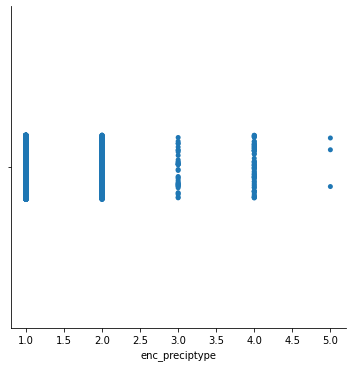

In [31]:
plt.figure(figsize=(10,8))
sns.catplot(data=weather_data, x="enc_preciptype")

snow

In [32]:
weather_data['snow'].describe()

count    5831.000000
mean        0.019317
std         0.142421
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         6.600000
Name: snow, dtype: float64

In [33]:
weather_data[weather_data['snow']>2]['conditions'].unique()

array(['Partially cloudy'], dtype=object)

In [34]:
weather_data[weather_data['snow']>2].index

DatetimeIndex(['2022-01-08 09:00:00'], dtype='datetime64[ns]', name='datetime', freq=None)

windspeed

In [35]:
weather_data['windspeed'].describe()

count    5831.000000
mean       17.790070
std         8.714233
min         0.000000
25%        11.200000
50%        16.500000
75%        23.700000
max        64.000000
Name: windspeed, dtype: float64

<AxesSubplot:xlabel='windspeed', ylabel='Count'>

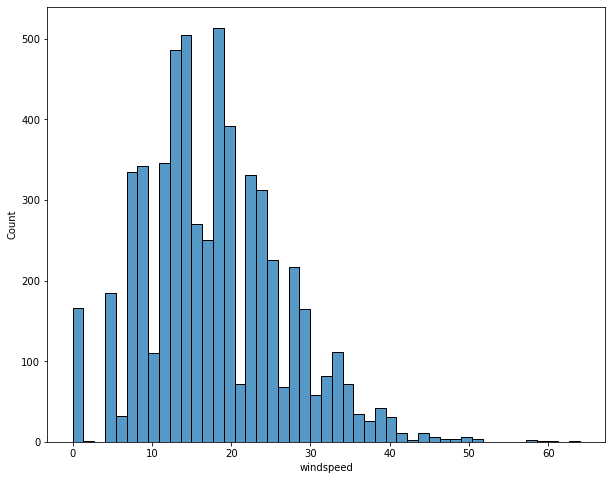

In [36]:
plt.figure(figsize=(10,8))
sns.histplot(data=weather_data, x="windspeed")

Conditions

In [37]:
weather_data['conditions'].unique()

array(['Overcast', 'Rain, Overcast', 'Partially cloudy', 'Clear',
       'Snow, Rain, Overcast', 'Snow, Overcast', 'Rain, Partially cloudy',
       'Snow, Ice, Overcast', 'Snow, Partially cloudy'], dtype=object)

In [38]:
'''
mapping a dict in conditions column to transform it in categorical with Label Encoding. 
We group-label them according to the type of precipitation
'''
weather_data['enc_conditions'] = weather_data['conditions'].map(lambda row: main.ConditionsMap(row)).astype('int32')

In [39]:
weather_data.drop('conditions', axis=1, inplace=True)
weather_data.head()

,temp,feelslike,humidity,precip,snow,snowdepth,windspeed,visibility,solarradiation,uvindex,severerisk,enc_preciptype,enc_conditions
datetime,,,,,,,,,,,,,
2022-01-01 00:00:00,7.8,7.8,92.50,0.0,0.0,0.0,0.1,8.0,NaN,NaN,NaN,1,1
2022-01-01 01:00:00,7.2,6.5,96.49,0.0,0.0,0.0,5.3,5.1,NaN,NaN,NaN,1,1
2022-01-01 02:00:00,7.2,6.0,96.49,0.0,0.0,0.0,7.3,4.0,NaN,NaN,NaN,1,1
2022-01-01 03:00:00,7.2,7.2,96.60,0.0,0.0,0.0,0.1,1.0,NaN,NaN,NaN,1,1
2022-01-01 04:00:00,6.8,5.4,99.79,0.0,0.0,0.0,7.4,0.0,NaN,NaN,NaN,1,1


Severerisk

In [40]:
weather_data['severerisk'].unique()

array([nan, 10.,  3.,  5., 30., 15.,  8., 60., 75.])

In [41]:
'''
since there are nan values we could say that they are days with no risk
'''
weather_data['severerisk'].fillna(weather_data['severerisk'].median(), inplace=True)

solar radiation

In [42]:
weather_data['solarradiation'].min()

0.0

In [43]:
#weather_data[weather_data['solarradiation'].isna()==True]
weather_data[weather_data['solarradiation']==0.0]['severerisk'].unique()

array([10.,  3.,  5., 15., 30., 60.,  8.])

In [44]:
weather_data[weather_data['solarradiation']==0.0]['enc_conditions'].unique()

array([1, 2, 3], dtype=int32)

In [45]:
weather_data[weather_data['solarradiation'].isna()==True]['severerisk'].unique()

array([10.])

In [46]:
'''
it is nan during the hours with out sun and that's why we fill the missing values with 0.0
'''
sorted(weather_data[weather_data['solarradiation'].isna()==True].index)

[Timestamp('2022-01-01 00:00:00'),
 Timestamp('2022-01-01 01:00:00'),
 Timestamp('2022-01-01 02:00:00'),
 Timestamp('2022-01-01 03:00:00'),
 Timestamp('2022-01-01 04:00:00'),
 Timestamp('2022-01-01 05:00:00'),
 Timestamp('2022-01-01 06:00:00'),
 Timestamp('2022-01-01 07:00:00'),
 Timestamp('2022-01-01 17:00:00'),
 Timestamp('2022-01-01 18:00:00'),
 Timestamp('2022-01-01 19:00:00'),
 Timestamp('2022-01-01 20:00:00'),
 Timestamp('2022-01-01 21:00:00'),
 Timestamp('2022-01-01 22:00:00'),
 Timestamp('2022-01-01 23:00:00'),
 Timestamp('2022-01-02 00:00:00'),
 Timestamp('2022-01-02 01:00:00'),
 Timestamp('2022-01-02 02:00:00'),
 Timestamp('2022-01-02 03:00:00'),
 Timestamp('2022-01-02 04:00:00'),
 Timestamp('2022-01-02 05:00:00'),
 Timestamp('2022-01-02 06:00:00'),
 Timestamp('2022-01-02 07:00:00'),
 Timestamp('2022-01-02 17:00:00'),
 Timestamp('2022-01-02 18:00:00'),
 Timestamp('2022-01-02 19:00:00'),
 Timestamp('2022-01-02 20:00:00'),
 Timestamp('2022-01-02 21:00:00'),
 Timestamp('2022-01-

In [47]:
weather_data['solarradiation'].fillna(0.0, inplace=True)

UVindex

In [48]:
weather_data['uvindex'].unique()

array([nan,  0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10.])

In [49]:
sorted(weather_data[weather_data['uvindex'].isna()==True].index)

[Timestamp('2022-01-01 00:00:00'),
 Timestamp('2022-01-01 01:00:00'),
 Timestamp('2022-01-01 02:00:00'),
 Timestamp('2022-01-01 03:00:00'),
 Timestamp('2022-01-01 04:00:00'),
 Timestamp('2022-01-01 05:00:00'),
 Timestamp('2022-01-01 06:00:00'),
 Timestamp('2022-01-01 07:00:00'),
 Timestamp('2022-01-01 17:00:00'),
 Timestamp('2022-01-01 18:00:00'),
 Timestamp('2022-01-01 19:00:00'),
 Timestamp('2022-01-01 20:00:00'),
 Timestamp('2022-01-01 21:00:00'),
 Timestamp('2022-01-01 22:00:00'),
 Timestamp('2022-01-01 23:00:00'),
 Timestamp('2022-01-02 00:00:00'),
 Timestamp('2022-01-02 01:00:00'),
 Timestamp('2022-01-02 02:00:00'),
 Timestamp('2022-01-02 03:00:00'),
 Timestamp('2022-01-02 04:00:00'),
 Timestamp('2022-01-02 05:00:00'),
 Timestamp('2022-01-02 06:00:00'),
 Timestamp('2022-01-02 07:00:00'),
 Timestamp('2022-01-02 17:00:00'),
 Timestamp('2022-01-02 18:00:00'),
 Timestamp('2022-01-02 19:00:00'),
 Timestamp('2022-01-02 20:00:00'),
 Timestamp('2022-01-02 21:00:00'),
 Timestamp('2022-01-

In [50]:
'''
the same as before
'''
weather_data['uvindex'].fillna(0.0, inplace=True)

In [51]:
weather_data.head()

,temp,feelslike,humidity,precip,snow,snowdepth,windspeed,visibility,solarradiation,uvindex,severerisk,enc_preciptype,enc_conditions
datetime,,,,,,,,,,,,,
2022-01-01 00:00:00,7.8,7.8,92.50,0.0,0.0,0.0,0.1,8.0,0.0,0.0,10.0,1,1
2022-01-01 01:00:00,7.2,6.5,96.49,0.0,0.0,0.0,5.3,5.1,0.0,0.0,10.0,1,1
2022-01-01 02:00:00,7.2,6.0,96.49,0.0,0.0,0.0,7.3,4.0,0.0,0.0,10.0,1,1
2022-01-01 03:00:00,7.2,7.2,96.60,0.0,0.0,0.0,0.1,1.0,0.0,0.0,10.0,1,1
2022-01-01 04:00:00,6.8,5.4,99.79,0.0,0.0,0.0,7.4,0.0,0.0,0.0,10.0,1,1


### Data Resample In Intervals And Merging 

In [52]:
'''
again we group are data after cleaning them in the well-known intervals but with only a difference. 
Since we have hourly data in case of 15 and 30 minutes we assume the same conditions and in case of 2 hours we will 
calculate the mean of the previous 2 hours
'''
weather_data15 = weather_data.resample('15Min').fillna(method='ffill')
weather_data30 = weather_data.resample('30Min').fillna(method='ffill')
weather_data60 = weather_data
weather_data120 = weather_data.resample('2H').mean()

In [53]:
weather_data15.head(10)

,temp,feelslike,humidity,precip,snow,snowdepth,windspeed,visibility,solarradiation,uvindex,severerisk,enc_preciptype,enc_conditions
datetime,,,,,,,,,,,,,
2022-01-01 00:00:00,7.8,7.8,92.50,0.0,0.0,0.0,0.1,8.0,0.0,0.0,10.0,1,1
2022-01-01 00:15:00,7.8,7.8,92.50,0.0,0.0,0.0,0.1,8.0,0.0,0.0,10.0,1,1
2022-01-01 00:30:00,7.8,7.8,92.50,0.0,0.0,0.0,0.1,8.0,0.0,0.0,10.0,1,1
2022-01-01 00:45:00,7.8,7.8,92.50,0.0,0.0,0.0,0.1,8.0,0.0,0.0,10.0,1,1
2022-01-01 01:00:00,7.2,6.5,96.49,0.0,0.0,0.0,5.3,5.1,0.0,0.0,10.0,1,1
2022-01-01 01:15:00,7.2,6.5,96.49,0.0,0.0,0.0,5.3,5.1,0.0,0.0,10.0,1,1
2022-01-01 01:30:00,7.2,6.5,96.49,0.0,0.0,0.0,5.3,5.1,0.0,0.0,10.0,1,1
2022-01-01 01:45:00,7.2,6.5,96.49,0.0,0.0,0.0,5.3,5.1,0.0,0.0,10.0,1,1
2022-01-01 02:00:00,7.2,6.0,96.49,0.0,0.0,0.0,7.3,4.0,0.0,0.0,10.0,1,1


In [54]:
'''
It's time for merging our different dataframes
'''
picksup15 = main.MergingDataFrames(weather_data15, df15)
picksup30 = main.MergingDataFrames(weather_data30, df30)
picksup60 = main.MergingDataFrames(weather_data60, df60)
picksup120 = main.MergingDataFrames(weather_data120, df120)

### Weekend/Weekday & Holidays & Month/Hour/Minute & Season

In [55]:
'''
creating a dictionary for one-hot encoding the season and then we specify the final weather columns we are going
to use, considering them as the most relevant
'''
season_month =  {1:'Winter', 2:'Winter',
                3:'Spring', 4:'Spring', 5:'Spring',
                6:'Summer', 7:'Summer', 8:'Summer'}
weather_columns = [
       'temp', 'feelslike', 'humidity', 
       'precip', 'snow', 'snowdepth',
       'windspeed', 'visibility', 'uvindex', 
       'severerisk', 'enc_preciptype', 'enc_conditions'
        ]

In [56]:
for pickup in [picksup15,picksup30, picksup60, picksup120]:
    pickup = main.DataPreprocess(pickup, season_month)
    pickup = pd.get_dummies(pickup, 'season')

### Final Dataset for EDA

In [57]:
'''
formatting the final dataset for the next step of visualizations by creating also the
relevant lags
'''
picksup15 = pd.get_dummies(picksup15, 'season')
picksup30 = pd.get_dummies(picksup30, 'season')
picksup60 = pd.get_dummies(picksup60, 'season')
picksup120 = pd.get_dummies(picksup120, 'season')
picksup15 = main.WeatherLaging(picksup15, 15, weather_columns)
picksup30 = main.WeatherLaging(picksup30, 30, weather_columns)
picksup60 = main.WeatherLaging(picksup60, 60, weather_columns)
picksup120 = main.WeatherLaging(picksup120, 120, weather_columns)

## Extra Informations 

The columns we have kept so far are:

* temp - temperature in Celsius
* feelslike - "feels like" temperature in Celsius
* humidity - relative humidity
* precip - the quantity of precipitation of any kind
* snow - the quantity of snowing
* snowdepth - how much snow has fallen
* windspeed - wind speed
* visibility - how clean the atmosphere is
* solarradiation - solar radiation
* uvindex - Ultraviolet index 
* severeisk - an index with the severity of the weather
* enc_preciptype - 
                   1: no precipitation
                   2: rain
                   3: rain,snow
                   4: snow
                   5: freezingrain,snow,ice
                 
* enc_conditions - 
                   1: 'Overcast','Partially cloudy','Clear'
                   2: 'Rain, Overcast','Rain, Partially cloudy','Snow, Partially cloudy'
                   3: 'Snow, Rain, Overcast','Snow, Overcast','Snow, Ice, Overcast'
* workingday - whether the day is neither a weekend or not
* holiday - whether the day is considered a holiday
* casual - number of non-registered user rentals initiated
* registered - number of registered user rentals initiated
* season - 1 = spring, 2 = summer, 3 = fall, 4 = winter
* pickups - number of total rentals (Dependent Variable)

In [58]:
'''
select one of the different intervals assumimg the same behaviour from all of them
'''
picksup = picksup30.copy()

In [59]:
picksup.describe()

,temp,feelslike,humidity,precip,snow,snowdepth,windspeed,visibility,solarradiation,uvindex,...,workingday,holiday,month,hour,minute,season_Spring,season_Summer,season_Winter,"lag(pickups,60-90)","lag(pickups,90-120)"
count,11659.000000,11659.000000,11659.000000,11659.000000,11659.000000,11659.000000,11659.000000,11659.000000,11659.000000,11659.000000,...,11659.000000,11659.000000,11659.000000,11659.000000,11659.000000,11659.000000,11659.000000,11659.000000,11659.000000,11659.000000
mean,12.347663,10.589347,62.502053,0.077067,0.019322,2.161700,17.799580,14.869886,135.337679,1.339738,...,0.712154,0.028476,4.527661,11.502788,14.998713,0.378763,0.378677,0.242559,197.443005,197.346256
std,11.057928,13.413959,20.225247,0.451610,0.142433,5.760949,8.719053,3.543898,202.113948,2.045488,...,0.452779,0.166335,2.295053,6.920143,15.000643,0.485100,0.485078,0.428649,195.815357,195.601478
min,-15.600000,-26.500000,15.130000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,4.300000,0.800000,46.130000,0.000000,0.000000,0.000000,11.200000,16.000000,0.000000,0.000000,...,0.000000,0.000000,3.000000,6.000000,0.000000,0.000000,0.000000,0.000000,34.000000,34.000000
50%,12.900000,12.900000,61.270000,0.000000,0.000000,0.000000,16.500000,16.000000,16.000000,0.000000,...,1.000000,0.000000,5.000000,12.000000,0.000000,0.000000,0.000000,0.000000,137.000000,137.000000
75%,21.600000,21.600000,79.640000,0.000000,0.000000,0.000000,23.700000,16.000000,210.000000,2.000000,...,1.000000,0.000000,7.000000,17.500000,30.000000,1.000000,1.000000,0.000000,303.000000,303.000000
max,37.200000,39.500000,99.940000,10.546000,6.600000,36.000000,64.000000,16.000000,1006.000000,10.000000,...,1.000000,1.000000,8.000000,23.000000,30.000000,1.000000,1.000000,1.000000,1225.000000,1225.000000


    By creating a heatmap of correlation, at the first glance we are able to identify the following:
   * Pickups are significantly positively correlated: temp, feelslike,  month, hour, season and of course lags
   * Pickups are significantly negatively correlated: season and less with snowdepth, humidity
    
    Which means how the rides react in these measure changes.

<AxesSubplot:>

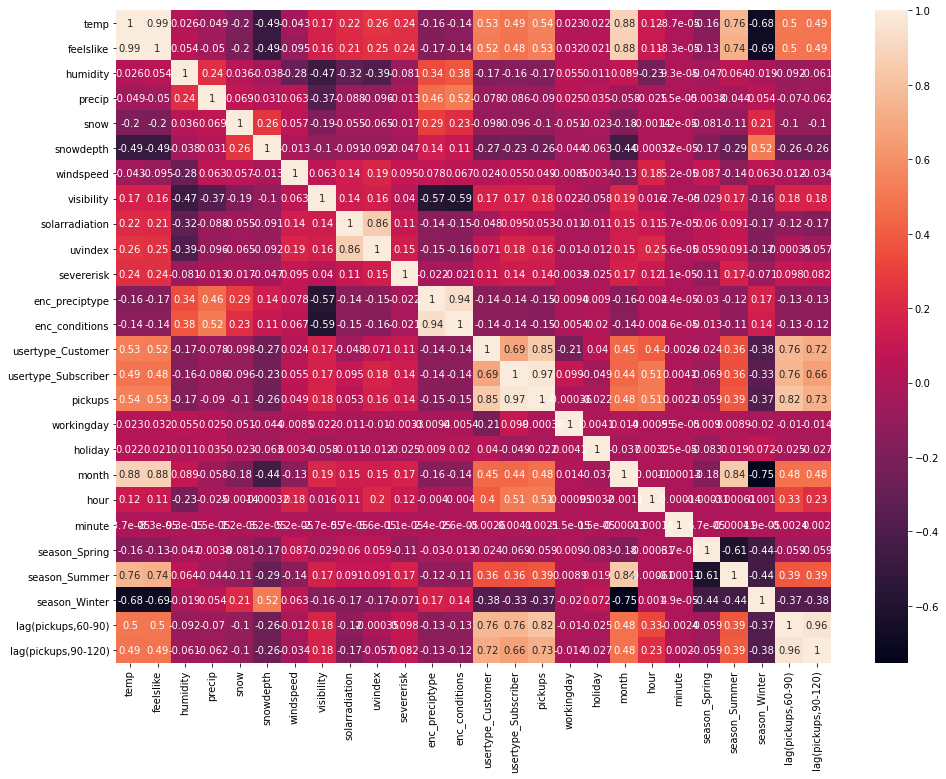

In [60]:
plt.figure(figsize=(16,12))
sns.heatmap(picksup.corr(), annot=True)

<Figure size 1152x576 with 0 Axes>

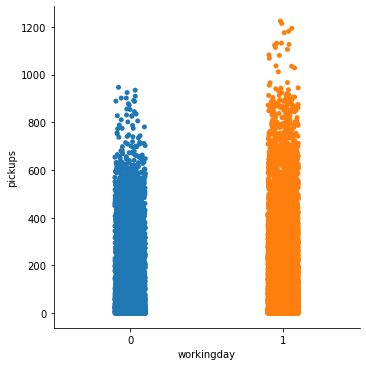

In [61]:
plt.figure(figsize=(16,8))
sns.catplot(data=picksup, x='workingday', y='pickups')

<Figure size 1152x576 with 0 Axes>

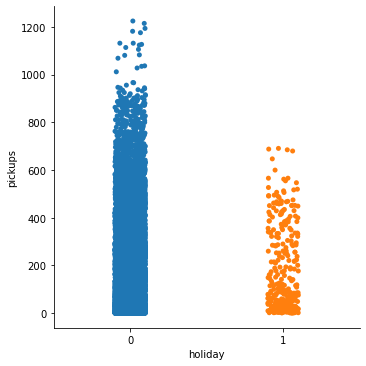

In [62]:
plt.figure(figsize=(16,8))
sns.catplot(data=picksup, x='holiday', y='pickups')

<AxesSubplot:xlabel='enc_conditions', ylabel='pickups'>

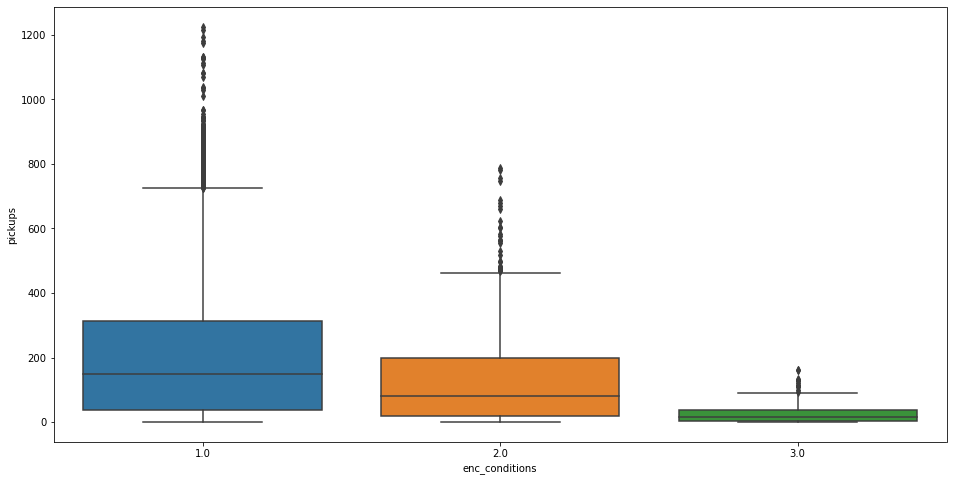

In [63]:
plt.figure(figsize=(16,8))
sns.boxplot(data=picksup, x='enc_conditions', y='pickups')

## Prediction

        Dropping the last columns we cocluded are not critical and transforming into category type the categorical one. Wnding up with the following columns:

In [64]:
for picks in [picksup15,picksup30,picksup60,picksup120]:
    picks.drop(['usertype_Customer','usertype_Subscriber','severerisk','solarradiation','snow','minute'], axis=1, inplace=True)
    picks[['enc_preciptype', 'enc_conditions','workingday', 'holiday','season_Spring', 'season_Summer',
       'season_Winter','month', 'hour']] = picks[['enc_preciptype', 'enc_conditions','workingday', 'holiday','season_Spring', 'season_Summer',
       'season_Winter','month', 'hour']].astype('category')

In [65]:
picksup15.columns

Index(['temp', 'feelslike', 'humidity', 'precip', 'snowdepth', 'windspeed',
       'visibility', 'uvindex', 'enc_preciptype', 'enc_conditions', 'pickups',
       'workingday', 'holiday', 'month', 'hour', 'season_Spring',
       'season_Summer', 'season_Winter', 'lag(pickups,60-75)',
       'lag(pickups,75-90)', 'lag(pickups,90-105)', 'lag(pickups,105-120)'],
      dtype='object')

In [66]:
picksup15.head()

,temp,feelslike,humidity,precip,snowdepth,windspeed,visibility,uvindex,enc_preciptype,enc_conditions,...,holiday,month,hour,season_Spring,season_Summer,season_Winter,"lag(pickups,60-75)","lag(pickups,75-90)","lag(pickups,90-105)","lag(pickups,105-120)"
8,7.2,6.5,96.49,0.0,0.0,5.3,5.1,0.0,1.0,1.0,...,1,1,2,0,0,1,30.0,29.0,36.0,30.0
9,7.2,6.5,96.49,0.0,0.0,5.3,5.1,0.0,1.0,1.0,...,1,1,2,0,0,1,21.0,30.0,29.0,36.0
10,7.2,6.5,96.49,0.0,0.0,5.3,5.1,0.0,1.0,1.0,...,1,1,2,0,0,1,22.0,21.0,30.0,29.0
11,7.2,6.5,96.49,0.0,0.0,5.3,5.1,0.0,1.0,1.0,...,1,1,2,0,0,1,24.0,22.0,21.0,30.0
12,7.2,6.0,96.49,0.0,0.0,7.3,4.0,0.0,1.0,1.0,...,1,1,3,0,0,1,25.0,24.0,22.0,21.0


In [67]:
# again we use the same way as before for the prediction.
def ModelRunningResults(models,models_name, first_row, picks, weather_columns):
    results = {}
    table = [first_row]
    pipe = main.PredictionPipeline(picks,weather_columns)
    fi_dict = {}
    predictions = {}
    X_train, X_test, y_train, y_test = pipe.PredictionDataPreperation()
    for model, model_name in zip(models,models_name):
        CV_score, CV_MSE, test_score, test_MSE, fi, preds = pipe.BackTestingPrediction(model, model_name, X_train, X_test, y_train, y_test)
        results[model_name] = {'Test Score':test_score, 'Test MSE':test_MSE,  'Features Importance':fi}
        row = [model_name, test_score, test_MSE]
        table.append(row)      
        fi_dict[model_name] = fi
        predictions[model_name] = preds
    return table, fi_dict, predictions, y_test['pickups']

In [68]:
models = [LinearRegression(),Ridge(),Lasso(),RandomForestRegressor(),ExtraTreesRegressor()]
models_name = ['LinearRegression','RidgeRegression','LassoRegression','RandomForestRegressor','ExtraTreesRegressor']
first_row = ['Model for 15','Final Test Score','Final Test RMSE']
weather_columns = ['feelslike', 'humidity', 'precip', 'snowdepth','windspeed', 'visibility', 'uvindex',]
print('The Prediction based on {} minutes intervals \n'.format(15))
table15, features_importance15, predictions15, y_test_values = ModelRunningResults(models,models_name, first_row, picksup15, weather_columns)

The Prediction based on 15 minutes intervals 


 LinearRegression

 Train Score:  0.7967390913559503
 Train RMSE :  12.059014561295006
 Test Score:     0.7678266608091979
 Test RMSE :     19.534192816987535

 Train Score:  0.798613473595351
 Train RMSE :  15.56566322296946
 Test Score:     0.7275783193153926
 Test RMSE :     29.20501428389684

 Train Score:  0.7834422227821805
 Train RMSE :  21.00335715087402
 Test Score:     0.7622631938584622
 Test RMSE :     38.24751715132423

 Train Score:  0.8097419331175716
 Train RMSE :  26.067600323335725
 Test Score:     0.7580350998152583
 Test RMSE :     45.09058202806411

 Train Score:  0.8169608380320491
 Train RMSE :  30.795296764346443
 Test Score:     0.7226478363756992
 Test RMSE :     56.765786061531

 Train Score:  0.808438973735359
 Train RMSE :  36.224173367026495
 Test Score:     0.7341219317490368
 Test RMSE :     55.286180206337406

 RidgeRegression

 Train Score:  0.7966469104206775
 Train RMSE :  12.061748695578132
 Test Score

In [69]:
print(tabulate(table15, headers='firstrow',colalign=("left",), floatfmt=".4f"))

Model for 15             Final Test Score    Final Test RMSE
---------------------  ------------------  -----------------
LinearRegression                   0.7457            64.3816
RidgeRegression                    0.7456            64.3845
LassoRegression                    0.7320            66.0940
RandomForestRegressor              0.8535            48.8664
ExtraTreesRegressor                0.8617            47.4819


In [70]:
print('Featutes importance 15 min\n')
for model in models_name:
    print(model,'\n')
    for i,f in enumerate(features_importance15[model]):
        print(f,'\n')

Featutes importance 15 min

LinearRegression 

('temp', 0.6024888866301362) 

('feelslike', 6.26520510397928) 

('humidity', -4.608978238488977) 

('precip', -0.5070179162736411) 

('snowdepth', -0.5710002961629469) 

('windspeed', 0.38631499547865483) 

('visibility', -0.7583473971681893) 

('uvindex', 1.739044628637104) 

('enc_preciptype', 1.6232845323111729) 

('enc_conditions', -6.112199665036933) 

('workingday', 1.0192384071071545) 

('holiday', -4.075833559872682) 

('month', 2.60073778396347) 

('hour', 2.54461359949013) 

('season_Spring', 0.664187548208373) 

('season_Summer', -3.1234670379213214) 

('season_Winter', 2.4592794897129595) 

('lag(pickups,60-75)', 94.59948453514384) 

('lag(pickups,75-90)', 6.245539712008118) 

('lag(pickups,90-105)', -18.425126139825988) 

('lag(pickups,105-120)', -17.788378933087966) 

RidgeRegression 

('temp', 0.607006459235016) 

('feelslike', 6.217806546727401) 

('humidity', -4.60816350291144) 

('precip', -0.5079885110435244) 

('snowde

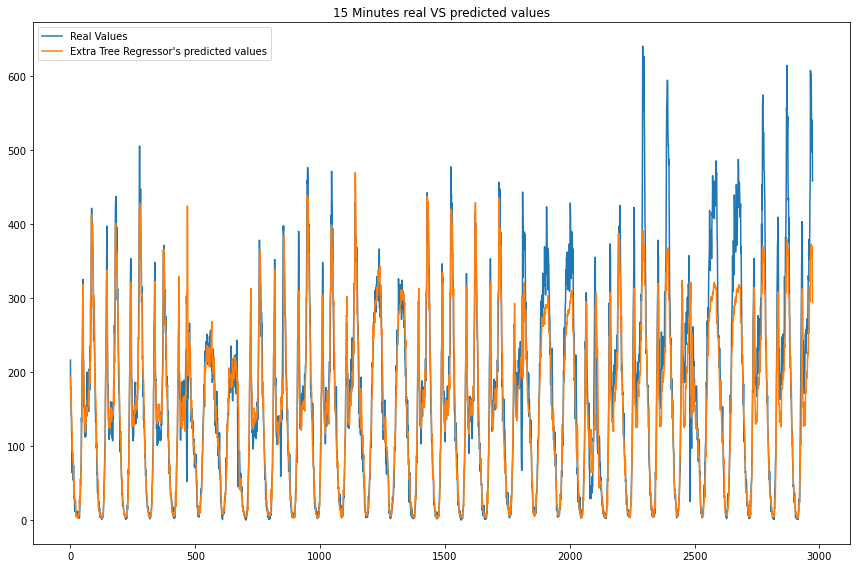

In [71]:
plt.figure(figsize=(12,8))
plt.title('15 Minutes real VS predicted values')
plt.plot(y_test_values.values, label='Real Values')
plt.plot(predictions15['ExtraTreesRegressor'], label="Extra Tree Regressor's predicted values")
plt.legend(loc="upper left")
plt.tight_layout()

In [72]:
models = [LinearRegression(),Ridge(),Lasso(),RandomForestRegressor(),ExtraTreesRegressor()]
models_name = ['LinearRegression','RidgeRegression','LassoRegression','RandomForestRegressor','ExtraTreesRegressor']
first_row = ['Model for 30min','Final Test Score','Final Test RMSE']
weather_columns = ['feelslike', 'humidity', 'precip', 'snowdepth','windspeed', 'visibility', 'uvindex',]
print('The Prediction based on {} minutes intervals \n'.format(30))
table30, features_importance30, predictions30, y_test_values = ModelRunningResults(models,models_name, first_row, picksup30,weather_columns)

The Prediction based on 30 minutes intervals 


 LinearRegression

 Train Score:  0.7916988514570253
 Train RMSE :  24.144535259208684
 Test Score:     0.7528243414860464
 Test RMSE :     39.93577968849003

 Train Score:  0.7902384081914835
 Train RMSE :  31.47027890689871
 Test Score:     0.7001335091165167
 Test RMSE :     60.82898330353259

 Train Score:  0.7673034288132181
 Train RMSE :  43.21348446689266
 Test Score:     0.7342247578750365
 Test RMSE :     80.33922590706871

 Train Score:  0.7923595406725805
 Train RMSE :  54.1311820999288
 Test Score:     0.7307473201520153
 Test RMSE :     94.49652931280119

 Train Score:  0.7992422636416721
 Train RMSE :  64.14335393358529
 Test Score:     0.6860466968121985
 Test RMSE :     120.03778272071021

 Train Score:  0.7877254735236627
 Train RMSE :  75.86301654237279
 Test Score:     0.6974078611163366
 Test RMSE :     117.23257648345069

 RidgeRegression

 Train Score:  0.7911255102452377
 Train RMSE :  24.177740896003147
 Test Score

In [73]:
print('\n\n',tabulate(table30, headers='firstrow',colalign=("left",), floatfmt=".4f"))



 Model for 30min          Final Test Score    Final Test RMSE
---------------------  ------------------  -----------------
LinearRegression                   0.7110           136.5539
RidgeRegression                    0.7109           136.5715
LassoRegression                    0.7027           138.5113
RandomForestRegressor              0.8531            97.3416
ExtraTreesRegressor                0.8658            93.0674


In [74]:
print('Featutes importance 30 min')
for model in models_name:
    print(model)
    for i,f in enumerate(features_importance30[model]):
        print(f,'\n')

Featutes importance 30 min
LinearRegression
('temp', 1.329676440151578) 

('feelslike', 13.922778872263526) 

('humidity', -10.077070357527852) 

('precip', -1.3743423186592574) 

('snowdepth', -1.3604580579717298) 

('windspeed', 0.7741980132884955) 

('visibility', -1.551082325036157) 

('uvindex', 4.154268332833975) 

('enc_preciptype', 3.5316671075221446) 

('enc_conditions', -13.157488247304405) 

('workingday', 2.416946768506123) 

('holiday', -9.018115945554827) 

('month', 6.078926344874121) 

('hour', 5.967576069082331) 

('season_Spring', 1.4632379282080612) 

('season_Summer', -7.036291342679622) 

('season_Winter', 5.573053414471628) 

('lag(pickups,60-90)', 209.02755228539414) 

('lag(pickups,90-120)', -89.1832651127256) 

RidgeRegression
('temp', 1.3507389493537547) 

('feelslike', 13.699986572382194) 

('humidity', -10.071972029456875) 

('precip', -1.3773198726098177) 

('snowdepth', -1.3589199481265815) 

('windspeed', 0.7614134569059257) 

('visibility', -1.5489746760

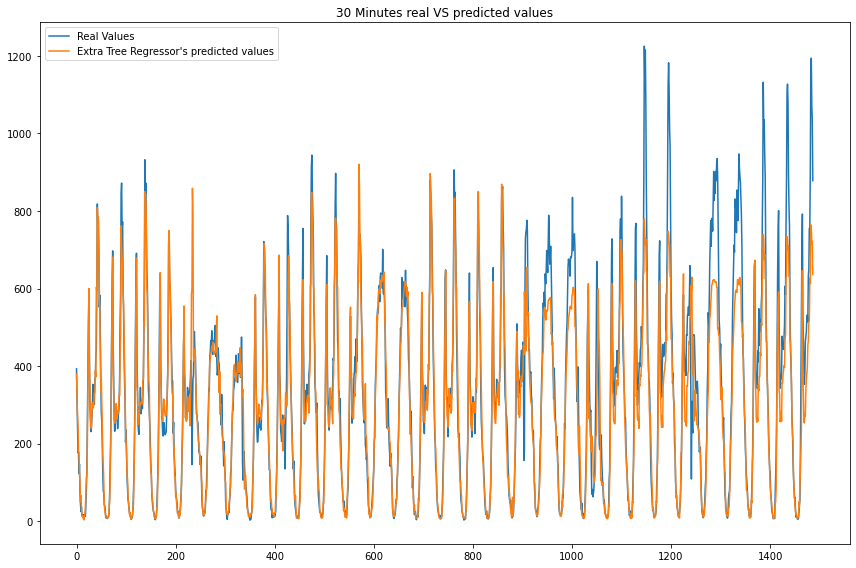

In [75]:
plt.figure(figsize=(12,8))
plt.title('30 Minutes real VS predicted values')
plt.plot(y_test_values.values, label='Real Values')
plt.plot(predictions30['ExtraTreesRegressor'], label="Extra Tree Regressor's predicted values")
plt.legend(loc="upper left")
plt.tight_layout()

In [76]:
models = [LinearRegression(),Ridge(),Lasso(),RandomForestRegressor(),ExtraTreesRegressor()]
models_name = ['LinearRegression','RidgeRegression','LassoRegression','RandomForestRegressor','ExtraTreesRegressor']
first_row = ['Model for 60','Final Test Score','Final Test RMSE']
weather_columns = ['feelslike', 'humidity', 'precip', 'snowdepth','windspeed', 'visibility', 'uvindex',]
print('The Prediction based on {} minutes intervals \n'.format(60))
table60, features_importance60, predictions60, y_test_values = ModelRunningResults(models,models_name, first_row, picksup60,weather_columns)

The Prediction based on 60 minutes intervals 


 LinearRegression

 Train Score:  0.7723140113416842
 Train RMSE :  49.94158624885183
 Test Score:     0.7153088988086465
 Test RMSE :     84.76710260466837

 Train Score:  0.7648774967217742
 Train RMSE :  65.9329964370649
 Test Score:     0.6341434746119116
 Test RMSE :     132.9683021900222

 Train Score:  0.7258384567790362
 Train RMSE :  92.91183824603472
 Test Score:     0.6633138178965355
 Test RMSE :     179.02097732529236

 Train Score:  0.7488232638631542
 Train RMSE :  118.07153656735717
 Test Score:     0.6589396707785806
 Test RMSE :     210.60498987647074

 Train Score:  0.7541820692221899
 Train RMSE :  140.83831134448414
 Test Score:     0.6016012515328
 Test RMSE :     267.51864937585776

 Train Score:  0.7381642386179201
 Train RMSE :  167.16391811117398
 Test Score:     0.6075664321918144
 Test RMSE :     264.37469166676243

 RidgeRegression

 Train Score:  0.7719414267866331
 Train RMSE :  49.98243166434174
 Test Score

In [77]:
print(tabulate(table60,headers='firstrow',colalign=("left",), floatfmt=".4f"))

Model for 60             Final Test Score    Final Test RMSE
---------------------  ------------------  -----------------
LinearRegression                   0.6159           311.6947
RidgeRegression                    0.6159           311.7024
LassoRegression                    0.6145           312.2669
RandomForestRegressor              0.8635           185.7917
ExtraTreesRegressor                0.8664           183.8122


In [78]:
for model in models_name:
    print(model)
    for f in features_importance60[model]:
        print(f,'\n')

LinearRegression
('temp', 4.156368005610714) 

('feelslike', 19.685509046954916) 

('humidity', -21.767241089839718) 

('precip', -2.6836484973099437) 

('snowdepth', -3.351707292266602) 

('windspeed', 0.5465150309496023) 

('visibility', -4.089720798550904) 

('uvindex', 17.15704725256907) 

('enc_preciptype', 7.053034312982888) 

('enc_conditions', -36.14536400355487) 

('workingday', 9.0607814809872) 

('holiday', -18.898029980931764) 

('month', 15.062909212476457) 

('hour', 17.82101776307295) 

('season_Spring', 3.189645767043337) 

('season_Summer', -17.213933985473762) 

('season_Winter', 14.024288218430362) 

('lag(pickups,60-120)', 208.00118264150194) 

RidgeRegression
('temp', 4.207516024999784) 

('feelslike', 19.15219246228866) 

('humidity', -21.76233615001592) 

('precip', -2.701631490219897) 

('snowdepth', -3.3438429065260555) 

('windspeed', 0.5157370704350018) 

('visibility', -4.067181922401089) 

('uvindex', 17.14136352504782) 

('enc_preciptype', 6.69013850238766

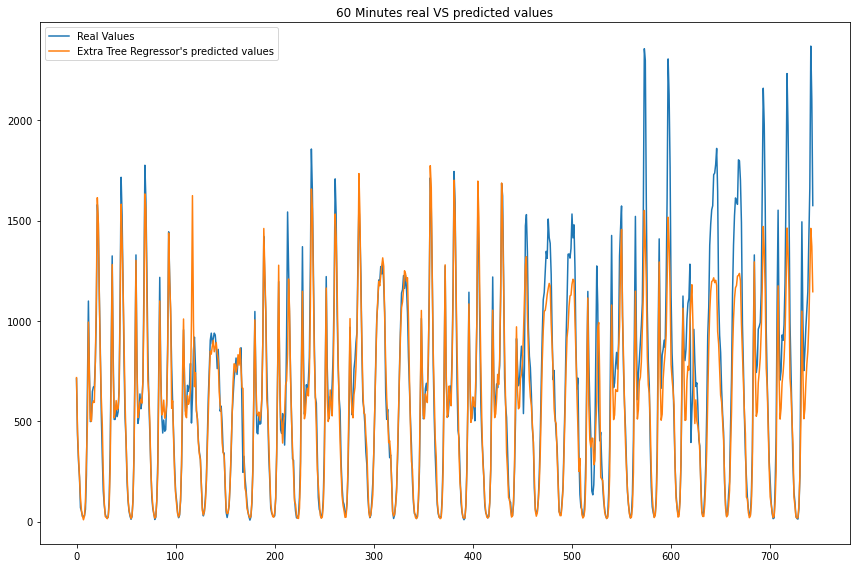

In [79]:
plt.figure(figsize=(12,8))
plt.title('60 Minutes real VS predicted values')
plt.plot(y_test_values.values, label='Real Values')
plt.plot(predictions60['ExtraTreesRegressor'], label="Extra Tree Regressor's predicted values")
plt.legend(loc="upper left")
plt.tight_layout()

In [80]:
models = [LinearRegression(),Ridge(),Lasso(),RandomForestRegressor(),ExtraTreesRegressor()]
models_name = ['LinearRegression','RidgeRegression','LassoRegression','RandomForestRegressor','ExtraTreesRegressor']
first_row = ['Model for 120','Final Test Score','Final Test RMSE']
weather_columns = ['feelslike', 'humidity', 'precip', 'snowdepth','windspeed', 'visibility', 'uvindex',]
print('The Prediction based on {} minutes intervals \n'.format(120))
table120, features_importance120, predictions120, y_test_values = ModelRunningResults(models,models_name, first_row, picksup120,weather_columns)

The Prediction based on 120 minutes intervals 


 LinearRegression

 Train Score:  0.827544133887939
 Train RMSE :  84.73382182824533
 Test Score:     0.7864419470397604
 Test RMSE :     142.60847534096703

 Train Score:  0.8216405502516233
 Train RMSE :  111.80648973129394
 Test Score:     0.7123487139231477
 Test RMSE :     228.0623094846462

 Train Score:  0.7894548066652869
 Train RMSE :  158.3529315358823
 Test Score:     0.723799588489872
 Test RMSE :     315.44623042203176

 Train Score:  0.80191992841065
 Train RMSE :  204.79404170932776
 Test Score:     0.7300424078837345
 Test RMSE :     363.2793467580036

 Train Score:  0.8081679979460145
 Train RMSE :  243.13597020881122
 Test Score:     0.687466646174722
 Test RMSE :     455.32187387861836

 Train Score:  0.7974419949305895
 Train RMSE :  286.61376110833174
 Test Score:     0.6953585415475871
 Test RMSE :     447.9216440760372

 RidgeRegression

 Train Score:  0.8265672856627138
 Train RMSE :  84.97346343590304
 Test Score

In [81]:
print('\n\n',tabulate(table120, headers='firstrow',colalign=("left",), floatfmt=".4f"))



 Model for 120            Final Test Score    Final Test RMSE
---------------------  ------------------  -----------------
LinearRegression                   0.6982           533.8585
RidgeRegression                    0.6982           533.8845
LassoRegression                    0.6974           534.5975
RandomForestRegressor              0.8574           367.0083
ExtraTreesRegressor                0.8818           334.1423


In [82]:
print('Featutes importance 120 min')
for model in models_name:
    print(model)
    for f in features_importance120[model]:
        print(f,'\n')

Featutes importance 120 min
LinearRegression
('temp', 7.715164523087931) 

('feelslike', 16.839300774010205) 

('humidity', -27.055983569360677) 

('precip', 1.4076929806000404) 

('snowdepth', -6.246740715328282) 

('windspeed', -0.5837699342582109) 

('visibility', -3.2351870283244404) 

('uvindex', 46.74277072022949) 

('enc_preciptype', 35.39206641794493) 

('enc_conditions', -98.07723526647614) 

('workingday', 18.475360485487506) 

('holiday', -26.841653556261768) 

('month', 24.95088358461382) 

('hour', 35.45766330076451) 

('season_Spring', 4.039215346444744) 

('season_Summer', -26.97762164808973) 

('season_Winter', 22.93840630164495) 

('lag(pickups,0-120)', 465.60801906019265) 

RidgeRegression
('temp', 7.8057434595585375) 

('feelslike', 15.921880507175306) 

('humidity', -27.117227988416147) 

('precip', 1.2396746568369312) 

('snowdepth', -6.216702131938699) 

('windspeed', -0.6445665538109173) 

('visibility', -3.1108948282137625) 

('uvindex', 46.60755819695812) 

('e

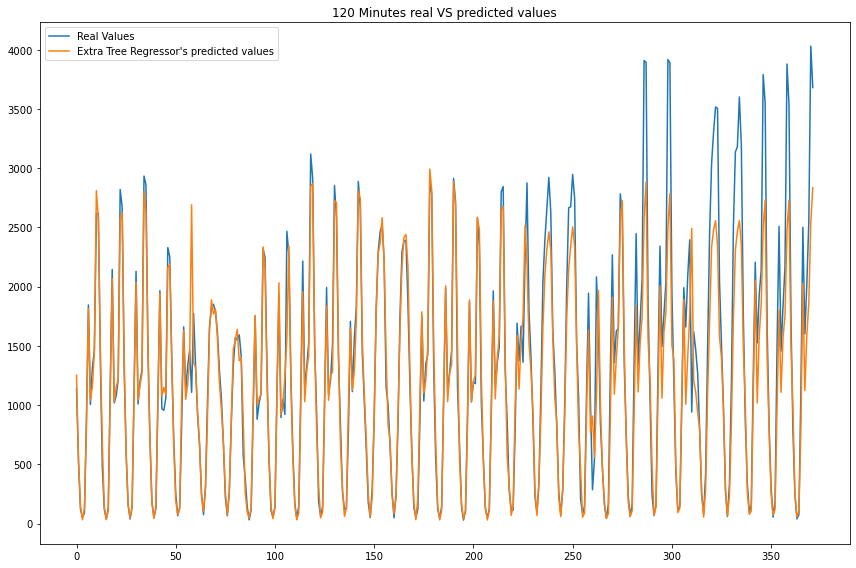

In [83]:
plt.figure(figsize=(12,8))
plt.title('120 Minutes real VS predicted values')
plt.plot(y_test_values.values, label='Real Values')
plt.plot(predictions120['ExtraTreesRegressor'], label="Extra Tree Regressor's predicted values")
plt.legend(loc="upper left")
plt.tight_layout()

    Like before, the best algorithms are the non-linear ensemble models and they are also slighlty better than before. Backtesting strategy confirm our prediction, and the small overfitting remains. Definitely the most important features remain the lags of the intervals for both linear and non linear models with the hour following. However, linear models seems to be more sensitove also in weather columns like uvindex, humidity, conditions. Another inference, is that this sensitive is smoother in smaller time intervals than the bigger one. All in all, champion of models is again the ExtraTreesRegressor with the lowest RMSE and highest score and the linear models are better to figure the trend in smaller intervals when on the other hand the ensmble are slightly better on the bigger.

# Part 2. Stations Clustering

    And as we promised, let's start the most difficult part of the project! The prediction in station-clusters level. In this part we try to identify possible clusters in bike stations and predict their rides. We won't dive a lot into, just to have something left for the future :)

In [84]:
clustering_data = pd.read_csv('BikeSharing_Bluebikes2022.csv', index_col=0)

/home/georgep/anaconda3/envs/MachineLearning/lib/python3.8/site-packages/numpy/lib/arraysetops.py:580: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask |= (ar1 == a)


In [85]:
#transforming the dates from object to datetime
for date_column in ['starttime','stoptime']:
    clustering_data[date_column] = pd.to_datetime(clustering_data[date_column], format='%Y-%m-%d %H:%M:%S')

     Using the Elbow Curve algorithm to predict the clusters of stations, as in cluster analysis elbow curve is a heuristic used in determining the number of clusters in a data set. The method consists of plotting the explained variation as a function of the number of clusters and picking the elbow of the curve as the number of clusters to use.

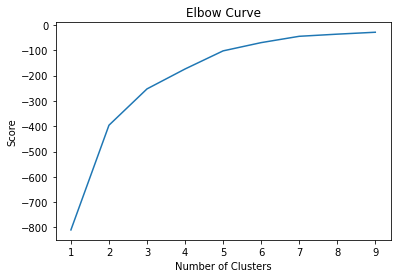

In [86]:
K_clusters = range(1,10)
kmeans = [KMeans(n_clusters=i) for i in K_clusters]
Y_axis = np.array(data.loc[:,'start station latitude']).reshape(-1,1)
X_axis = np.array(data.loc[:,'start station longitude']).reshape(-1,1)
score = [kmeans[i].fit(Y_axis).score(Y_axis) for i in range(len(kmeans))]
# Visualize
plt.plot(K_clusters, score)
plt.xlabel('Number of Clusters')
plt.ylabel('Score')
plt.title('Elbow Curve')
plt.show()

    After the Elbow Curve algorithm, we select 5 clusters as we see this is approximatelly the threshold of optimal value of clusters, from 5-7.

In [86]:
# creates 5 clusters using k-means clustering algorithm.
kmeans = KMeans(n_clusters = 5, init ='k-means++')
kmeans.fit(clustering_data.loc[:,['start station latitude','start station longitude']]) # Compute k-means clustering.
clustering_data['cluster_label'] = kmeans.fit_predict(clustering_data.loc[:,['start station latitude','start station longitude']])
centers = kmeans.cluster_centers_ # Coordinates of cluster centers.
labels = kmeans.predict(clustering_data.loc[:,['start station latitude','start station longitude']]) # Labels of each point

    The number of rides per cluster.

In [87]:
clustering_data['cluster_label'].value_counts()

1    647412
0    640150
2    550503
3    463484
4      4186
Name: cluster_label, dtype: int64

In [88]:
clustering_data = clustering_data.join(clustering_data['cluster_label'].value_counts(), on='cluster_label', lsuffix='', rsuffix='count')

In [89]:
clustering_data.head()

,tripduration,starttime,stoptime,start station id,start station name,start station latitude,start station longitude,end station id,end station name,end station latitude,end station longitude,bikeid,usertype,postal code,cluster_label,cluster_labelcount
0,597,2022-01-01 00:00:25.166,2022-01-01 00:10:22.192,178,MIT Pacific St at Purrington St,42.359573,-71.101295,74,Harvard Square at Mass Ave/ Dunster,42.373268,-71.118579,4923,Subscriber,02139,1,647412
1,411,2022-01-01 00:00:40.430,2022-01-01 00:07:32.198,189,Kendall T,42.362428,-71.084955,178,MIT Pacific St at Purrington St,42.359573,-71.101295,3112,Subscriber,02139,1,647412
2,476,2022-01-01 00:00:54.818,2022-01-01 00:08:51.668,94,Main St at Austin St,42.375603,-71.064608,356,Charlestown Navy Yard,42.374125,-71.054812,6901,Customer,02124,0,640150
3,466,2022-01-01 00:01:01.608,2022-01-01 00:08:48.235,94,Main St at Austin St,42.375603,-71.064608,356,Charlestown Navy Yard,42.374125,-71.054812,5214,Customer,02124,0,640150
4,752,2022-01-01 00:01:06.052,2022-01-01 00:13:38.230,19,Park Dr at Buswell St,42.347241,-71.105301,41,Packard's Corner - Commonwealth Ave at Brighto...,42.352261,-71.123831,2214,Subscriber,02215,2,550503


In [90]:
clustering_data.columns

Index(['tripduration', 'starttime', 'stoptime', 'start station id',
       'start station name', 'start station latitude',
       'start station longitude', 'end station id', 'end station name',
       'end station latitude', 'end station longitude', 'bikeid', 'usertype',
       'postal code', 'cluster_label', 'cluster_labelcount'],
      dtype='object')

     First visualization of the clusters, without layout.

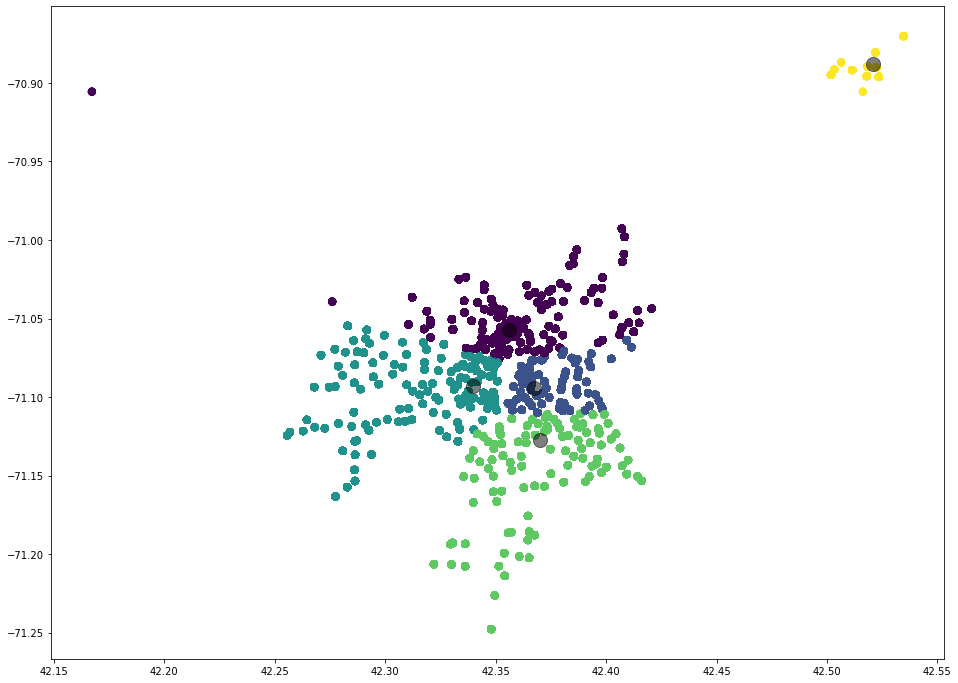

In [91]:
plt.figure(figsize=(16,12))
plt.scatter(x = 'start station latitude', y = 'start station longitude', data=data, c=labels, s=50)
plt.scatter(centers[:, 0], centers[:, 1], c='black', s=200, alpha=0.5)

    The second and much better visualization of them, using the map of Massachusetts as layout. For reasons of memory we have used only a sample of the data. Zooming in the city the prediction seems well.

In [92]:
plt.figure(figsize=(16,12))
main.get_location_interactive(clustering_data[['start station latitude','start station longitude','cluster_label', 'cluster_labelcount']].sample(n=100000))

<Figure size 1152x864 with 0 Axes>

    There is also a small cluster up here in Salem which the plot could not interpret. Probably this is because of the few data we have plotted.

In [93]:
plt.figure(figsize=(16,12))
main.get_location_interactive(clustering_data[['start station latitude','start station longitude','cluster_label', 'cluster_labelcount']].sample(n=100000))

<Figure size 1152x864 with 0 Axes>

In [94]:
cdf15 = main.DatetimeInterval(clustering_data, freq='15Min')
cdf30 = main.DatetimeInterval(clustering_data, freq='30Min')
cdf60 = main.DatetimeInterval(clustering_data, freq='60Min')
cdf120 = main.DatetimeInterval(clustering_data, freq='120Min')

In [95]:
cdf120.head()

,usertype_Customer,usertype_Subscriber,cluster_label_0,cluster_label_1,cluster_label_2,cluster_label_3,cluster_label_4,pickups
starttime,,,,,,,,
2022-01-01 00:00:00,59.0,158.0,68.0,61.0,60.0,28.0,0.0,217.0
2022-01-01 02:00:00,86.0,82.0,57.0,39.0,48.0,24.0,0.0,168.0
2022-01-01 04:00:00,111.0,104.0,108.0,38.0,48.0,21.0,0.0,215.0
2022-01-01 06:00:00,189.0,94.0,111.0,51.0,71.0,50.0,0.0,283.0
2022-01-01 08:00:00,38.0,18.0,18.0,12.0,13.0,13.0,0.0,56.0


    We need to transform the data in a way we could apply our model. Selecting only the 60 minutes inteval, we apply our new type of models, the Multi Output Regressors.

In [96]:
df = cdf60.copy()
minutes = 60
df['month'] = df.index.month
df['hour'] = df.index.hour
df['minute'] = df.index.minute
clusters_columns = [c for c in df.columns if c.startswith("cluster_label")]
for ind,c in enumerate(clusters_columns):
    for i in range(int(((120/minutes)/2) +1), int((120/minutes) +1)):
        df['lag(pickups of cluster_label_{},{}-{})'.format(ind,i*minutes-minutes,i*minutes)] = df[c].shift(i)
df = df.dropna().drop(['usertype_Customer','usertype_Subscriber'], axis=1)

    This is our dataset's final format. Columns with the clusters pickups occuring during the index datetime and the lags with the pickups two hours ago. Based on that, we are going to create our train and test sets.

In [97]:
df.head()

,cluster_label_0,cluster_label_1,cluster_label_2,cluster_label_3,cluster_label_4,pickups,month,hour,minute,"lag(pickups of cluster_label_0,60-120)","lag(pickups of cluster_label_1,60-120)","lag(pickups of cluster_label_2,60-120)","lag(pickups of cluster_label_3,60-120)","lag(pickups of cluster_label_4,60-120)"
starttime,,,,,,,,,,,,,,
2022-01-01 02:00:00,31.0,20.0,12.0,10.0,0.0,73.0,1,2,0,45.0,39.0,24.0,17.0,0.0
2022-01-01 03:00:00,26.0,19.0,36.0,14.0,0.0,95.0,1,3,0,23.0,22.0,36.0,11.0,0.0
2022-01-01 04:00:00,46.0,18.0,18.0,9.0,0.0,91.0,1,4,0,31.0,20.0,12.0,10.0,0.0
2022-01-01 05:00:00,62.0,20.0,30.0,12.0,0.0,124.0,1,5,0,26.0,19.0,36.0,14.0,0.0
2022-01-01 06:00:00,66.0,26.0,43.0,39.0,0.0,174.0,1,6,0,46.0,18.0,18.0,9.0,0.0


In [98]:
X = df.drop(['pickups'], axis=1)
y = df[['month','hour','cluster_label_0','cluster_label_1','cluster_label_2','cluster_label_3','cluster_label_4']]

In [99]:
X_train = X[X['month']!=8].drop(['cluster_label_0','cluster_label_1','cluster_label_2','cluster_label_3','cluster_label_4'],axis=1)
X_test = X[X['month']==8].drop(['cluster_label_0','cluster_label_1','cluster_label_2','cluster_label_3','cluster_label_4'],axis=1)

In [100]:
y_train = y[y['month']!=8][['cluster_label_0','cluster_label_1','cluster_label_2','cluster_label_3','cluster_label_4']]
y_test = y[y['month']==8][['cluster_label_0','cluster_label_1','cluster_label_2','cluster_label_3','cluster_label_4']]

    We are going to use a special type of regressors this time, the MultiOutputRegressor from sklearn which are a Multi target regression. This strategy consists of fitting one regressor per target. This is a simple strategy for extending regressors that do not natively support multi-target regression. And for the purpose of prediction we will test a linear and a non-linear model, LinearRegression() vs  RandomForestRegressor().

In [101]:
MORLinear = MultiOutputRegressor(LinearRegression())
MORETress = MultiOutputRegressor(ExtraTreesRegressor())

In [112]:
MORLinear.fit(X_train,y_train)
predsLinear = MORLinear.predict(X_test)
print('MultiOutputRegressor(LinearRegression)')
print(MORLinear.score(X_test,y_test.values))
print(np.sqrt(mean_squared_error(predsLinear,y_test.values)))

MultiOutputRegressor(LinearRegression)
0.5248864922096287
73.07309039238756


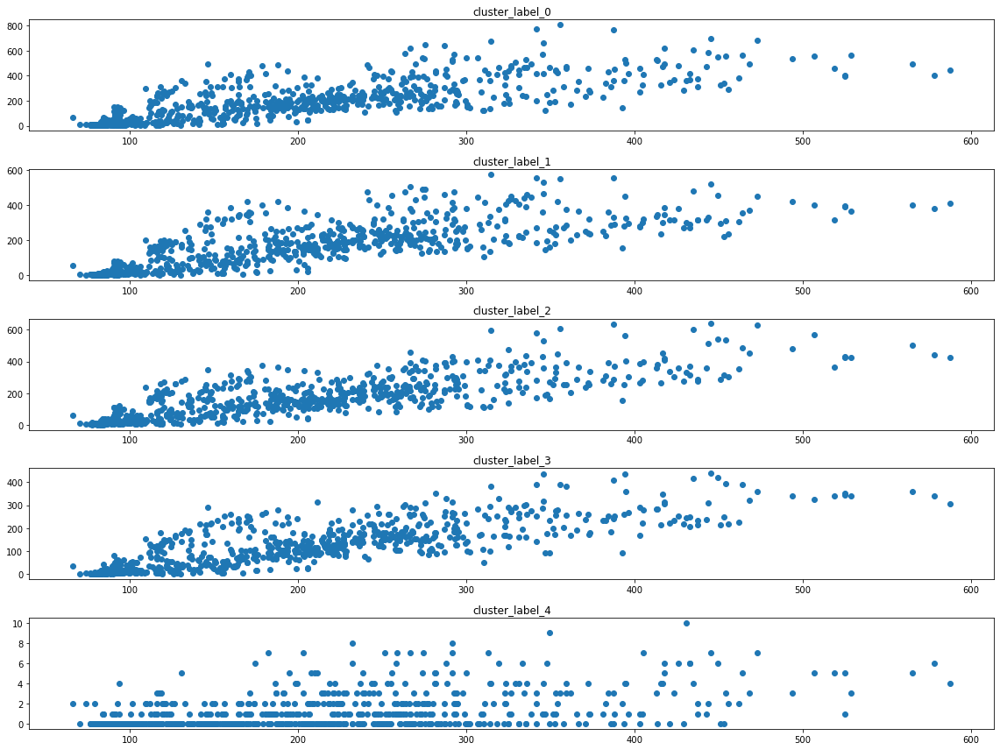

In [105]:
fig, axs = plt.subplots(len(y_test.columns), figsize=(16,12))

for i in range(len(y_test.columns)):
    axs[i].scatter(predsLinear[:,0],y_test.iloc[:,i].values)
    axs[i].set_title(y_test.columns[i])
plt.tight_layout()

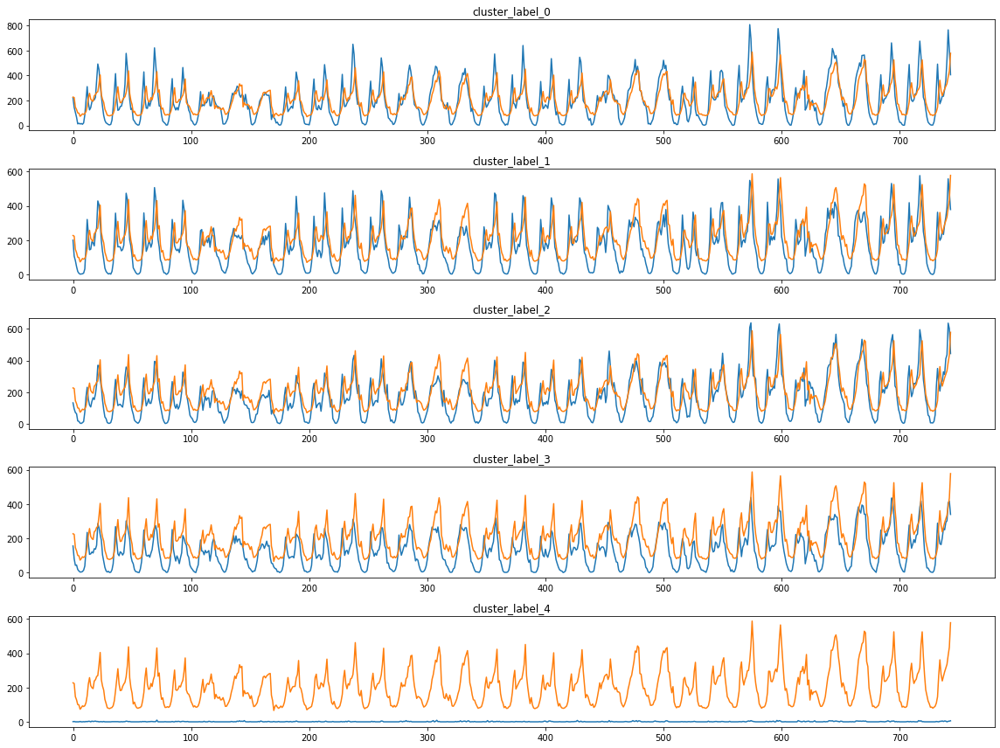

In [106]:
fig, axs = plt.subplots(len(y_test.columns), figsize=(16,12))

for i in range(len(y_test.columns)):
    axs[i].plot(y_test.iloc[:,i].values)
    axs[i].plot(predsLinear[:,0])
    axs[i].set_title(y_test.columns[i])
plt.tight_layout()

In [114]:
MORETress.fit(X_train,y_train)
predsTress = MORETress.predict(X_test)
print('MultiOutputRegressor(ExtraTreesRegressor)')
print(MORETress.score(X_test,y_test.values))
print(np.sqrt(mean_squared_error(predsTress,y_test.values)))

MultiOutputRegressor(ExtraTreesRegressor)
0.6718506549018661
48.790495913706145


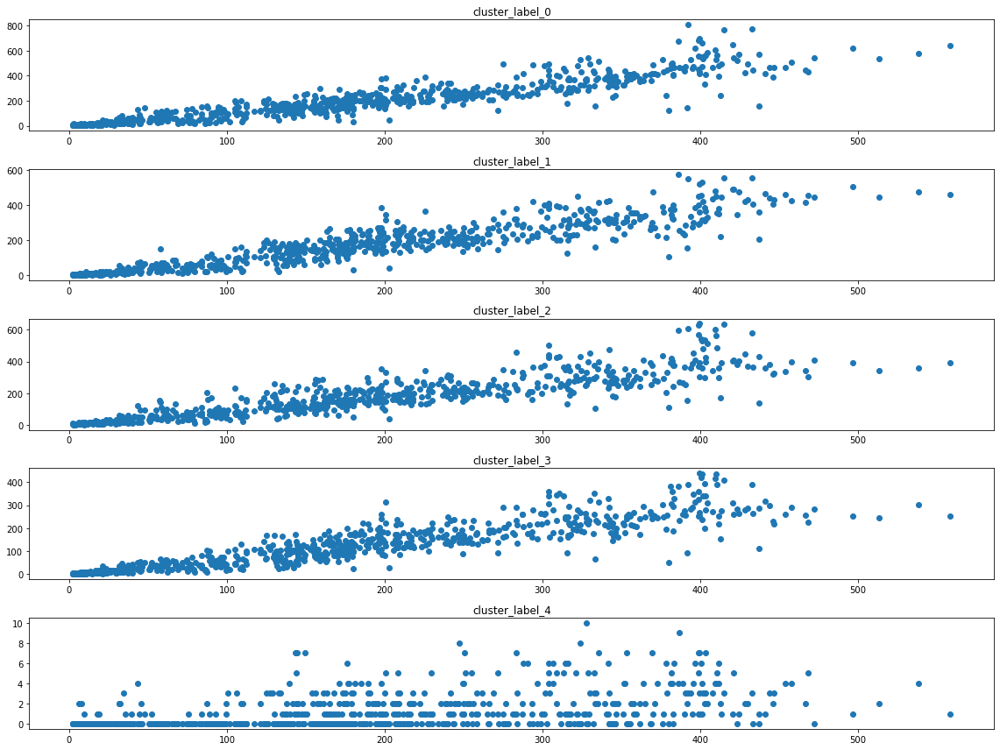

In [115]:
fig, axs = plt.subplots(len(y_test.columns), figsize=(16,12))
plt.title('60 minutes intervals')

for i in range(len(y_test.columns)):
    axs[i].scatter(predsTress[:,0],y_test.iloc[:,i].values)
    axs[i].set_title(y_test.columns[i])
plt.tight_layout()

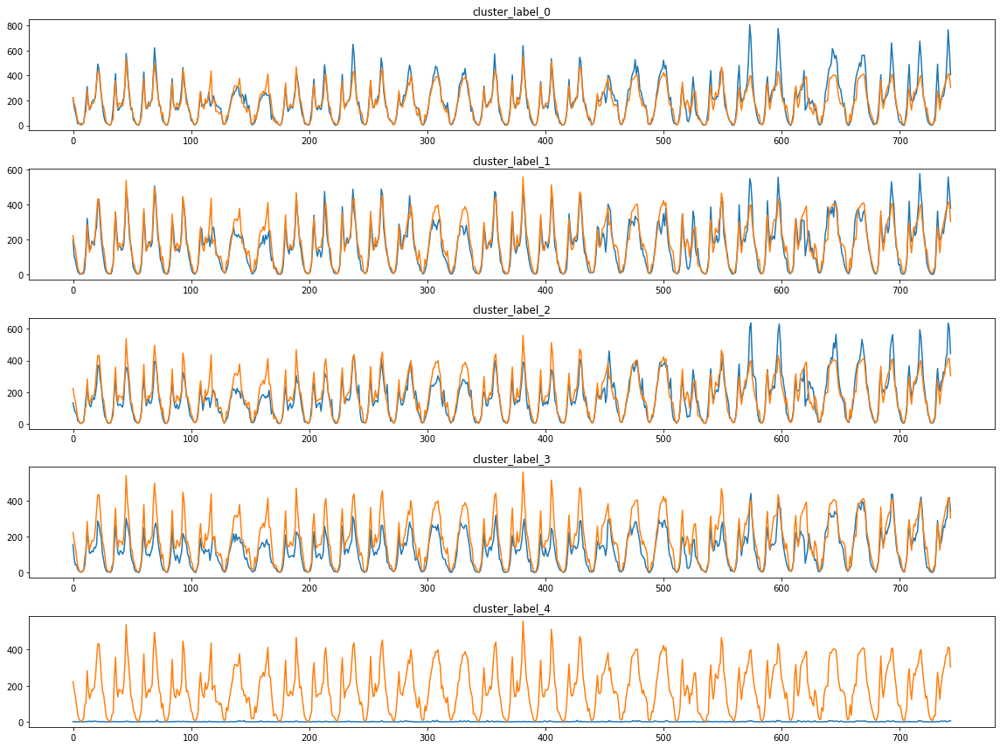

In [118]:
fig, axs = plt.subplots(len(y_test.columns), figsize=(16,12))
plt.title('60 minutes intervals')

for i in range(len(y_test.columns)):
    axs[i].plot(y_test.iloc[:,i].values)
    axs[i].plot(predsTress[:,0])
    axs[i].set_title(y_test.columns[i])
plt.tight_layout()

    In a nutshell, our prediction didn't make us much more wise because we didn't identify a model with good prediction score although the 0.67195 R^2 of MultiOutputRegressor(ExtraTreesRegressor) is the benchmark model we were asked in project's description. The model as we can see is not able to understand the changes after a specific point where the rides raise a lot and in top of that none of the model is capable at all to predict the cluster_4. The cluster with the very few rides, the smallest of all. To sum up, the models have potential if they will be combined with more data like weather data, more observations and with the correct parametrization of them.